In [138]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt
#%matplotlib inline
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from sklearn.impute import SimpleImputer
import warnings
warnings.filterwarnings('ignore',category=FutureWarning)
warnings.filterwarnings('ignore')

Context

The MSI comp-activ database comprises activity measures of computer systems. Data was gathered from a MSI model 20/712 with 128 Mbytes of memory, operating in a multi-user university department. Users engaged in diverse tasks, such as internet access, file editing, and CPU-intensive programs.

Being an aspiring data scientist, you aim to establish a linear equation for predicting 'usr' (the percentage of time CPUs operate in user mode). Your goal is to analyze various system attributes to understand their influence on the system's 'usr' mode.


DATA DICTIONARY:

System measures used:

    lread - Reads (transfers per second ) between system memory and user memory
    lwrite - writes (transfers per second) between system memory and user memory
    scall - Number of system calls of all types per second
    sread - Number of system read calls per second .
    swrite - Number of system write calls per second .
    fork - Number of system fork calls per second.
    exec - Number of system exec calls per second.
    rchar - Number of characters transferred per second by system read calls
    wchar - Number of characters transfreed per second by system write calls
    pgout - Number of page out requests per second
    ppgout - Number of pages, paged out per second
    pgfree - Number of pages per second placed on the free list.
    pgscan - Number of pages checked if they can be freed per second
    atch - Number of page attaches (satisfying a page fault by reclaiming a page in memory) per second
    pgin - Number of page-in requests per second
    ppgin - Number of pages paged in per second
    pflt - Number of page faults caused by protection errors (copy-on-writes).
    vflt - Number of page faults caused by address translation .
    runqsz - Process run queue size (The number of kernel threads in memory that are waiting for a CPU to run. Typically, this value should be less than 2. Consistently higher values mean that the system might be CPU-bound.)
    freemem - Number of memory pages available to user processes
    freeswap - Number of disk blocks available for page swapping.
    usr - Portion of time (%) that cpus run in user mode



In [139]:
df = pd.read_excel('MSI_compactiv.xlsx')


In [140]:
df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,NaN,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,NaN,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,NaN,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [141]:
df.tail()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
8187,16,12,3009,360,244,1.6,5.81,405250.0,85282.0,8.02,...,55.11,0.6,35.87,47.90,139.28,270.74,CPU_Bound,387,986647,80
8188,4,0,1596,170,146,2.4,1.80,89489.0,41764.0,3.80,...,0.20,0.8,3.80,4.40,122.40,212.60,Not_CPU_Bound,263,1055742,90
8189,16,5,3116,289,190,0.6,0.60,325948.0,52640.0,0.40,...,0.00,0.4,28.40,45.20,60.20,219.80,Not_CPU_Bound,400,969106,87
8190,32,45,5180,254,179,1.2,1.20,62571.0,29505.0,1.40,...,18.04,0.4,23.05,24.25,93.19,202.81,CPU_Bound,141,1022458,83
8191,2,0,985,55,46,1.6,4.80,111111.0,22256.0,0.00,...,0.00,0.2,3.40,6.20,91.80,110.00,CPU_Bound,659,1756514,94


In [142]:
df.shape

(8192, 22)

In [143]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8088 non-null   float64
 8   wchar     8177 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6



Insights:

    Data consists of both categorical and numerical values.
    There are total of 8192 rows and 22 columns in the dataset. Out of 22, only 1 columns is of object type,8 columns are of integer type and remaining 13 are of float data type.



In [144]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
lread,8192.0,1.955969e+01,53.353799,0.0,2.0,7.0,20.000,1845.00
lwrite,8192.0,1.310620e+01,29.891726,0.0,0.0,1.0,10.000,575.00
scall,8192.0,2.306318e+03,1633.617322,109.0,1012.0,2051.5,3317.250,12493.00
sread,8192.0,2.104800e+02,198.980146,6.0,86.0,166.0,279.000,5318.00
swrite,8192.0,1.500582e+02,160.478980,7.0,63.0,117.0,185.000,5456.00
fork,8192.0,1.884554e+00,2.479493,0.0,0.4,0.8,2.200,20.12
exec,8192.0,2.791998e+00,5.212456,0.0,0.2,1.2,2.800,59.56
rchar,8088.0,1.973857e+05,239837.493526,278.0,34091.5,125473.5,267828.750,2526649.00
wchar,8177.0,9.590299e+04,140841.707911,1498.0,22916.0,46619.0,106101.000,1801623.00
pgout,8192.0,2.285317e+00,5.307038,0.0,0.0,0.0,2.400,81.44


Insights: The reads (lread) between system and memory has maximum value than writes (lwrite) between system and memory.

In [145]:
df.duplicated().sum()

np.int64(0)

In [146]:
df.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

In [147]:
for column in df.columns:
    counts = df[column].value_counts()
    print(f"Value counts for {column}:\n{counts}\n")

Value counts for lread:
lread
1      1050
2       732
0       675
3       539
4       408
       ... 
556       1
817       1
292       1
102       1
129       1
Name: count, Length: 235, dtype: int64

Value counts for lwrite:
lwrite
0      2684
1      1529
2       615
3       284
4       253
       ... 
103       1
168       1
181       1
136       1
267       1
Name: count, Length: 189, dtype: int64

Value counts for scall:
scall
220     10
158     10
230      9
166      9
310      9
        ..
2084     1
4903     1
2790     1
5925     1
717      1
Name: count, Length: 4115, dtype: int64

Value counts for sread:
sread
16      43
10      41
43      40
12      38
146     37
        ..
1037     1
540      1
1283     1
1446     1
912      1
Name: count, Length: 794, dtype: int64

Value counts for swrite:
swrite
91      56
30      56
24      53
118     51
45      50
        ..
492      1
412      1
477      1
1011     1
1051     1
Name: count, Length: 640, dtype: int64

Value counts for f

In [148]:
# Select numerical columns
num_columns = df.select_dtypes(include=['int64', 'float64']).columns

# Select categorical columns
cat_columns = df.select_dtypes(include=['object', 'category']).columns

In [149]:
num_columns

Index(['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar',
       'wchar', 'pgout', 'ppgout', 'pgfree', 'pgscan', 'atch', 'pgin', 'ppgin',
       'pflt', 'vflt', 'freemem', 'freeswap', 'usr'],
      dtype='object')

In [150]:
cat_columns

Index(['runqsz'], dtype='object')

# Uni-variate Analysis

# Categorical

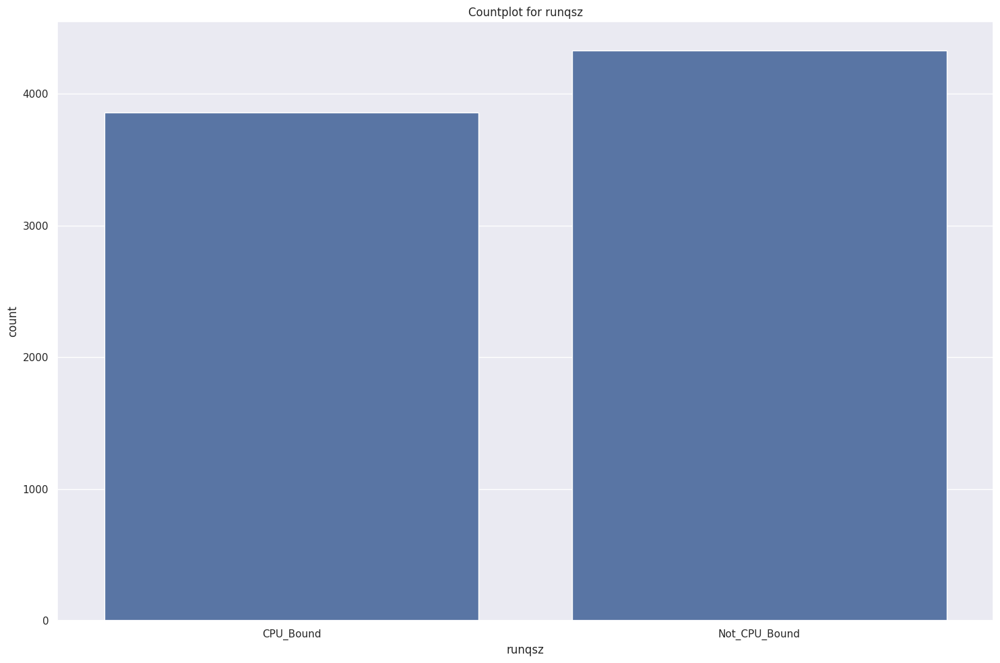

In [151]:
fig, ax = plt.subplots(figsize=(15, 10))

# Loop through the selected columns and draw countplots on a single set of axes
for column in cat_columns:
    sns.countplot(x=column, data=df, ax=ax)
    ax.set_title(f'Countplot for {column}')

# Adjust layout to prevent overlapping titles
plt.tight_layout()

# Show the plot
plt.show()

Insights: Not_CPU_Bound has the highest count than the CPU_bound

In [152]:
# Loop through the selected columns
for column in cat_columns:
    count_info = df[column].value_counts()
    print(f'Count information for {column}:\n{count_info}\n{"="*30}\n')


Count information for runqsz:
runqsz
Not_CPU_Bound    4331
CPU_Bound        3861
Name: count, dtype: int64



# Numerical

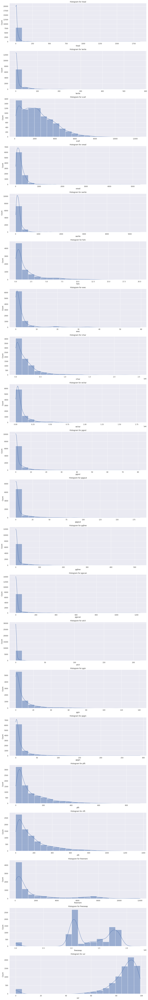

In [153]:
# Set up subplots dynamically
fig, axes = plt.subplots(nrows=21, ncols=1, figsize=(15, 100))

# Draw histplot for each numerical column
for i, column in enumerate(num_columns):
    sns.histplot(df[column], bins=20, kde=True, ax=axes[i])
    axes[i].set_title(f'Histogram for {column}')

# Adjust layout to prevent overlapping titles
plt.tight_layout()

# Show the plot
plt.show()


In [154]:
# # Calculate and display histogram values for each numerical column
# for column in num_columns:
#     hist_values, bin_edges = np.histogram(df[column], bins=20)
#     bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
    
#     print(f'Histogram values for {column}:')
#     for center, value in zip(bin_centers, hist_values):
#         print(f'Bin Center: {center}, Count: {value}')
#     print('\n')

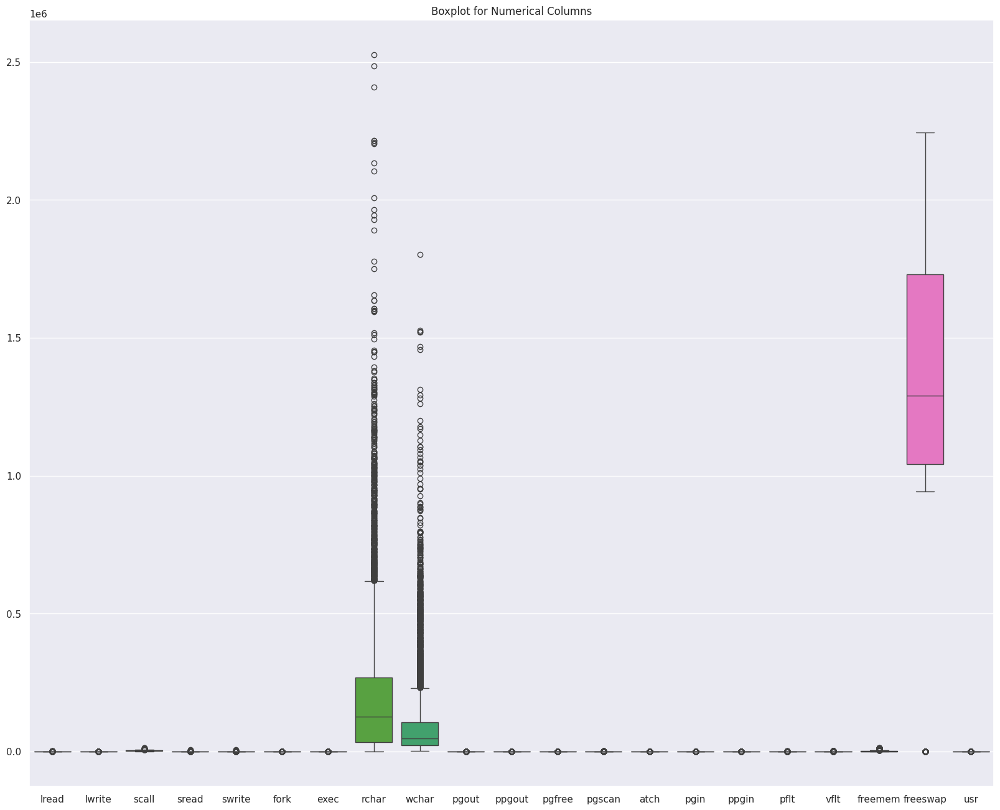

In [155]:
# Set up subplot for boxplot
fig, axes = plt.subplots(figsize=(20,16))

# Draw boxplot for all numerical columns
sns.boxplot(data=df[num_columns], ax=axes)
axes.set_title('Boxplot for Numerical Columns')

# Show the boxplot
plt.show()

In [156]:
# Create a boxplot using Plotly Express
fig = px.box(df, y=num_columns, title='Boxplot for Numerical Columns')
fig.update_layout(height=600, width=1000)
fig.update_xaxes(tickangle=90)
# Show the plot
fig.show()

# Bivariate Analysis

# Numeric Vs Numeric

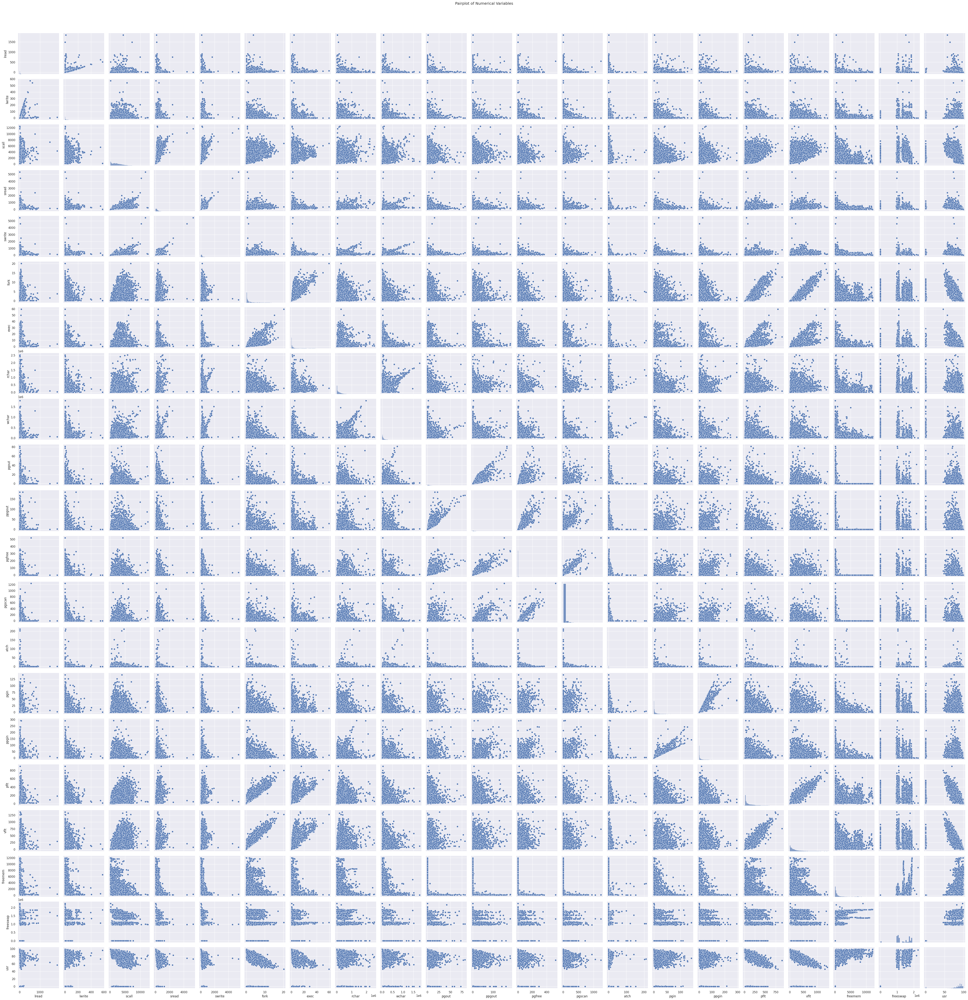

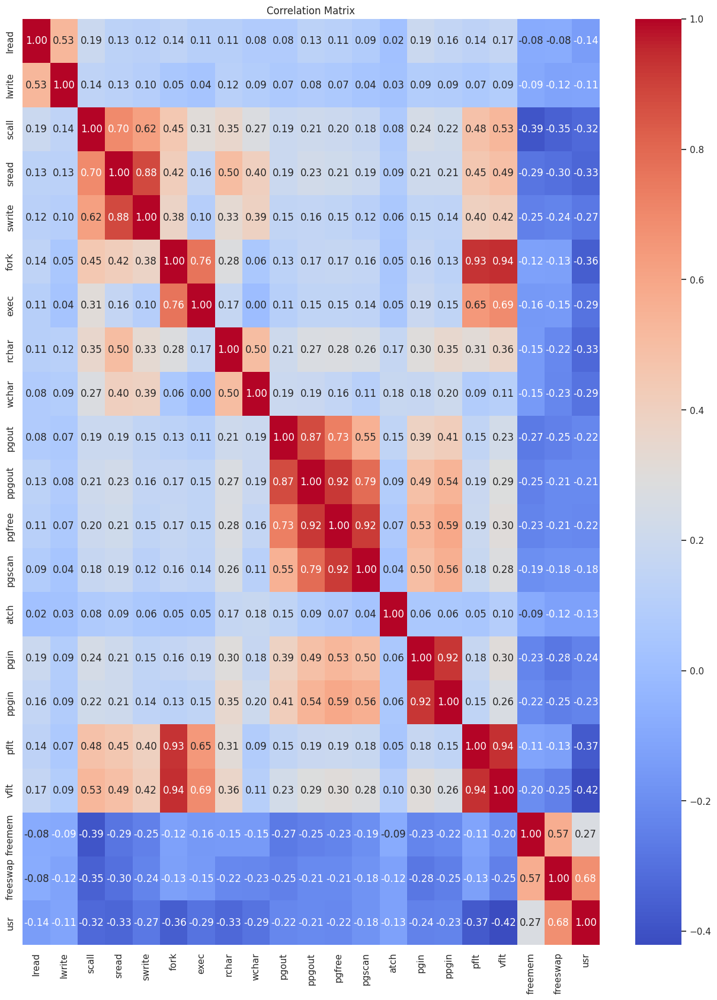

In [157]:
# Pairplot
sns.pairplot(df[num_columns])
plt.suptitle("Pairplot of Numerical Variables", y=1.02)
sns.set(rc={'figure.figsize':(15.7,20.27)})
#plt.savefig("pair_NvN.png", format="png", bbox_inches='tight')
plt.show()

# Correlation Matrix
correlation_matrix = df[num_columns].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix")
sns.set(rc={'figure.figsize':(15.7,20.27)})
#plt.savefig("corr_NvN.png", format="png", bbox_inches='tight')
plt.show()

# # Scatterplots
# for i in range(len(num_columns)):
#     for j in range(i+1, len(num_columns)):
#         plt.scatter(df[num_columns[i]], df[num_columns[j]])
#         plt.xlabel(num_columns[i])
#         plt.ylabel(num_columns[j])
#         plt.title(f'Scatterplot: {num_columns[i]} vs {num_columns[j]}')
#         #plt.savefig(f"scatter_NvN_{num_columns[i]}_vs_{num_columns[j]}.png", format="png", bbox_inches='tight')
#         plt.show()


# Jointplots
#for i in range(len(num_columns)):
#    for j in range(i+1, len(num_columns)):
#        sns.jointplot(x=num_columns[i], y=num_columns[j], data=df, kind='scatter')
#        fig.suptitle(f'Jointplot: {num_columns[i]} vs {num_columns[j]}', y=1.02)
        #plt.savefig(f"joint_NvN_{num_columns[i]}_vs_{num_columns[j]}.png", format="png", bbox_inches='tight')
#        plt.show()
        


In [874]:
# Convert correlation matrix to a long-form DataFrame for sorting
mask = np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool)
correlation_df = correlation_matrix.where(mask)
correlation_df = correlation_df.unstack().reset_index(name='Correlation').dropna()

# Sort the correlation DataFrame
sorted_correlation_df = correlation_df.sort_values(by='Correlation', ascending=False)

# Print the sorted correlation values
print("Sorted Correlation Matrix (Descending Order):")
for idx, row in sorted_correlation_df.iterrows():
    print(f"{row['level_0']} vs {row['level_1']}: {row['Correlation']:.2f}")


Sorted Correlation Matrix (Descending Order):
pgfree vs ppgout: 0.97
ppgin vs pgin: 0.96
ppgout vs pgout: 0.95
pflt vs fork: 0.94
vflt vs fork: 0.93
vflt vs pflt: 0.93
pgfree vs pgout: 0.91
swrite vs sread: 0.88
lwrite vs lread: 0.83
exec vs fork: 0.77
vflt vs exec: 0.76
sread vs scall: 0.76
pflt vs exec: 0.76
swrite vs scall: 0.74
atch vs pgout: 0.64
atch vs ppgout: 0.61
freeswap vs freemem: 0.61
atch vs pgfree: 0.60
vflt vs sread: 0.60
rchar vs sread: 0.58
usr vs freeswap: 0.56
vflt vs swrite: 0.56
vflt vs scall: 0.55
pflt vs sread: 0.53
fork vs sread: 0.53
fork vs swrite: 0.52
pflt vs swrite: 0.51
wchar vs rchar: 0.49
pflt vs scall: 0.49
ppgin vs pgfree: 0.48
ppgin vs ppgout: 0.48
fork vs scall: 0.47
pgin vs pgfree: 0.46
pgin vs ppgout: 0.46
ppgin vs pgout: 0.45
exec vs scall: 0.44
vflt vs rchar: 0.44
pgin vs pgout: 0.44
wchar vs swrite: 0.43
vflt vs lread: 0.42
rchar vs swrite: 0.42
wchar vs sread: 0.42
vflt vs pgin: 0.40
ppgin vs rchar: 0.39
rchar vs scall: 0.39
vflt vs ppgin: 0.3

Insight: There is a positive correlation between sread and swrite.There is a highest positive correlation between pgfree and ppgout.

# Categorical to Numerical

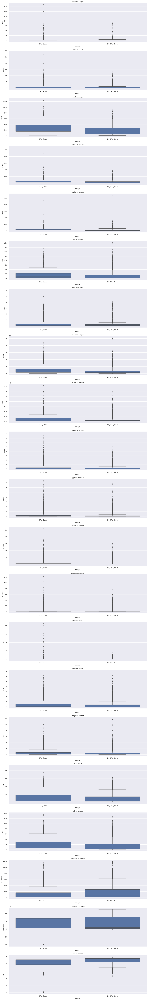

In [21]:
# Set up subplots
fig, axes = plt.subplots(nrows=len(num_columns), ncols=len(cat_columns), figsize=(15, 100))

# Flatten the axes array
axes = axes.flatten()

# Iterate through numerical and categorical columns for boxplots
for i, num_col in enumerate(num_columns):
    for j, cat_col in enumerate(cat_columns):
        # Create boxplot for the current combination
        sns.boxplot(x=cat_col, y=num_col, data=df, ax=axes[i * len(cat_columns) + j])
        axes[i * len(cat_columns) + j].set_title(f'{num_col} vs {cat_col}')

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
# # Iterate through numerical and categorical columns for statistical values
# for num_col in num_columns:
#     for cat_col in cat_columns:
#         # Extract statistical values for the current combination
#         stats = df.groupby(cat_col)[num_col].describe()
        
#         # Print the statistics
#         print(f"\nStatistics for {num_col} vs {cat_col}:\n{stats}")


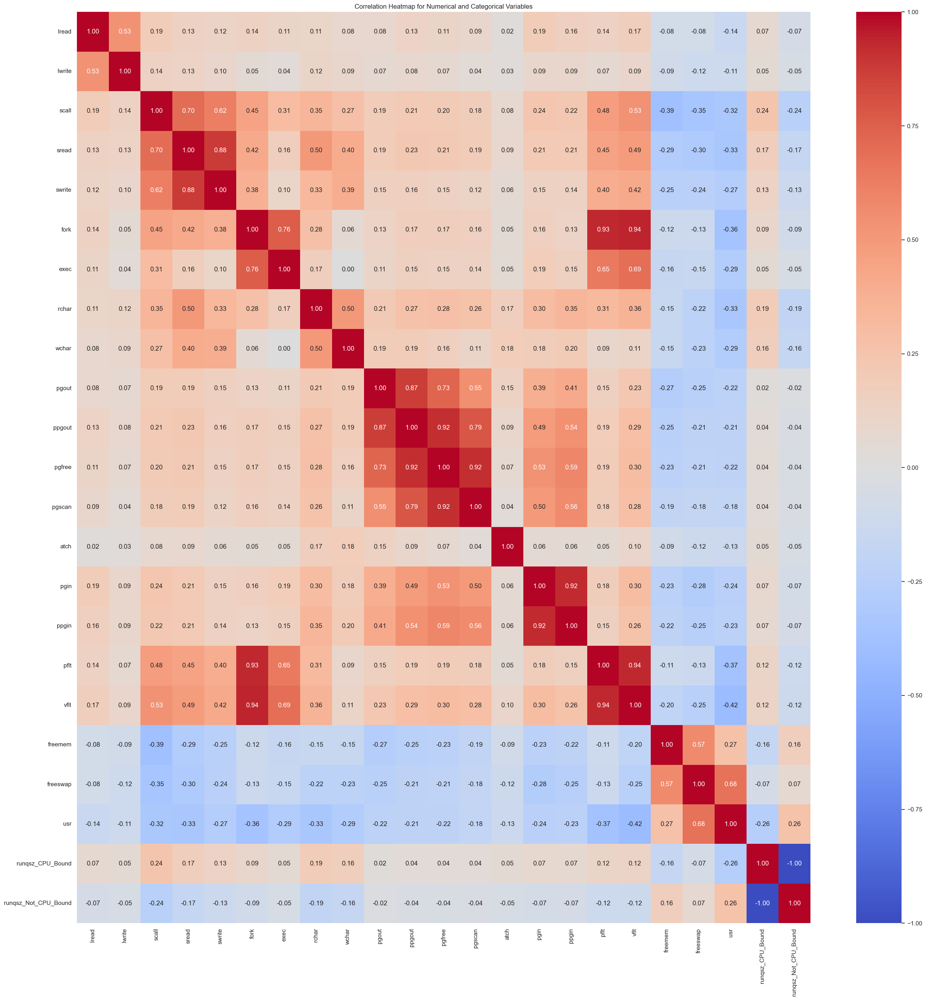

In [22]:
# Convert categorical columns to numerical using one-hot encoding
df_encoded = pd.get_dummies(df, columns=cat_columns)

# Exclude numerical columns from encoded categorical columns
cat_columns_encoded = [col for col in df_encoded.columns if col not in num_columns]
num_columns = [col for col in df_encoded.columns if col not in cat_columns_encoded]

# Combine numerical and encoded categorical columns
all_columns = num_columns + cat_columns_encoded

# Compute the correlation matrix
corr_matrix = df_encoded[all_columns].corr()

# Set up the matplotlib figure
plt.figure(figsize=(30, 30))

# Create a heatmap for the correlation matrix
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")

# Set the title
plt.title('Correlation Heatmap for Numerical and Categorical Variables')

# Show the plot
plt.show()

In [23]:
# Flatten the upper triangle of the correlation matrix
corr_values = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool)).stack().sort_values(ascending=False)

# Display correlations in descending order
print("Correlations in Descending Order:")
for index, value in corr_values.items():
    print(f"{index[0]} vs {index[1]}: {value:.2f}")


Correlations in Descending Order:
fork vs vflt: 0.94
pflt vs vflt: 0.94
fork vs pflt: 0.93
pgin vs ppgin: 0.92
ppgout vs pgfree: 0.92
pgfree vs pgscan: 0.92
sread vs swrite: 0.88
pgout vs ppgout: 0.87
ppgout vs pgscan: 0.79
fork vs exec: 0.76
pgout vs pgfree: 0.73
scall vs sread: 0.70
exec vs vflt: 0.69
freeswap vs usr: 0.68
exec vs pflt: 0.65
scall vs swrite: 0.62
pgfree vs ppgin: 0.59
freemem vs freeswap: 0.57
pgscan vs ppgin: 0.56
pgout vs pgscan: 0.55
ppgout vs ppgin: 0.54
lread vs lwrite: 0.53
pgfree vs pgin: 0.53
scall vs vflt: 0.53
rchar vs wchar: 0.50
sread vs rchar: 0.50
pgscan vs pgin: 0.50
sread vs vflt: 0.49
ppgout vs pgin: 0.49
scall vs pflt: 0.48
sread vs pflt: 0.45
scall vs fork: 0.45
sread vs fork: 0.42
swrite vs vflt: 0.42
pgout vs ppgin: 0.41
sread vs wchar: 0.40
swrite vs pflt: 0.40
swrite vs wchar: 0.39
pgout vs pgin: 0.39
swrite vs fork: 0.38
rchar vs vflt: 0.36
scall vs rchar: 0.35
rchar vs ppgin: 0.35
swrite vs rchar: 0.33
rchar vs pflt: 0.31
scall vs exec: 0.31




Insights:

    1. 'usr’ is the target variable and all other are predector variables.
    2. Looking into the fields in the univariate analsysis, we see there are outliers that needs to be treated
    3. Bivariate and multivariate analysis indicates that there is strong positive correlation between the target variable usr and the predictor variables freemem and freeswap.
    4. We also notice that there are no duplicates records in the given data set.



# Problem 1 - Data Pre-processing

In [24]:
df.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

In [25]:
#impute null values
df['rchar']=df['rchar'].fillna(df['rchar'].median())
df['wchar']=df['wchar'].fillna(df['wchar'].median())

In [26]:
df.isnull().sum()

lread       0
lwrite      0
scall       0
sread       0
swrite      0
fork        0
exec        0
rchar       0
wchar       0
pgout       0
ppgout      0
pgfree      0
pgscan      0
atch        0
pgin        0
ppgin       0
pflt        0
vflt        0
runqsz      0
freemem     0
freeswap    0
usr         0
dtype: int64

In [27]:
def remove_outlier(col):
    col = sorted(col)
    Q1, Q3 = np.percentile(col, [25, 75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5 * IQR)
    upper_range = Q3 + (1.5 * IQR)
    return lower_range, upper_range

# List to store the lower and upper ranges for each column
ranges = []

# Iterate through numerical columns and remove outliers
for num_col in num_columns:
    lr, ur = remove_outlier(df[num_col])
    print(f"For {num_col}, lower range is {lr} and upper range is {ur}")
    
    # Store the ranges for reference
    ranges.append((num_col, lr, ur))
    
    # Remove outliers in the dataframe
    df[num_col] = np.where(df[num_col] > ur, ur, df[num_col])
    df[num_col] = np.where(df[num_col] < lr, lr, df[num_col])

# Print the dataframe after removing outliers
print(df.head())


For lread, lower range is -25.0 and upper range is 47.0
For lwrite, lower range is -15.0 and upper range is 25.0
For scall, lower range is -2445.875 and upper range is 6775.125
For sread, lower range is -203.5 and upper range is 568.5
For swrite, lower range is -120.0 and upper range is 368.0
For fork, lower range is -2.3000000000000003 and upper range is 4.9
For exec, lower range is -3.6999999999999993 and upper range is 6.699999999999999
For rchar, lower range is -310940.875 and upper range is 611196.125
For wchar, lower range is -101611.125 and upper range is 230625.875
For pgout, lower range is -3.5999999999999996 and upper range is 6.0
For ppgout, lower range is -6.300000000000001 and upper range is 10.5
For pgfree, lower range is -7.5 and upper range is 12.5
For pgscan, lower range is 0.0 and upper range is 0.0
For atch, lower range is -0.8999999999999999 and upper range is 1.5
For pgin, lower range is -13.147500000000003 and upper range is 23.512500000000003
For ppgin, lower ran

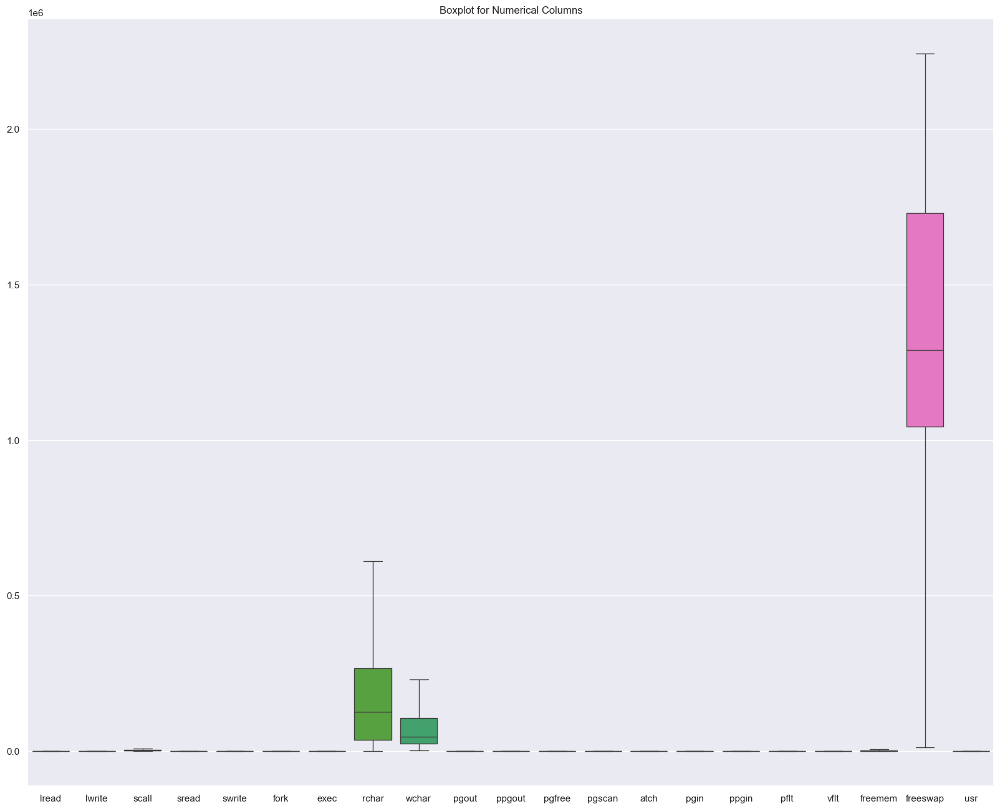

In [28]:
# Set up subplot for boxplot
fig, axes = plt.subplots(figsize=(20,16))

# Draw boxplot for all numerical columns
sns.boxplot(data=df[num_columns], ax=axes)
axes.set_title('Boxplot for Numerical Columns')

# Show the boxplot
plt.show()



Insights:

    1. In this case, it is not necessary to scale the data as, we'll get an equivalent solution whether we apply some kind of linear scaling or not because the data is on the same scale.
    2. Removing the records with 0 values is not a necessity, as it might not have an impact on the model building.
    3. Observed null values in 2 fields rchar and wchar.
    4. We imputed the null values with median value of the data set
    5. Most of the of the continuous fields had outliers.



In [29]:
#encoding data
df = pd.get_dummies(df, columns=['runqsz'], drop_first=True)
df

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.20,40671.0,53995.0,0.0,...,0.0,0.0,1.6000,2.60,16.00,26.40,4659.125,1730946.0,95.0,False
1,0.0,0.0,170.0,18.0,21.0,0.2,0.20,448.0,8385.0,0.0,...,0.0,0.0,0.0000,0.00,15.63,16.83,4659.125,1869002.0,97.0,True
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.40,125473.5,31950.0,0.0,...,0.0,1.2,6.0000,9.40,150.20,220.20,702.000,1021237.0,87.0,True
3,0.0,0.0,160.0,12.0,16.0,0.2,0.20,125473.5,8670.0,0.0,...,0.0,0.0,0.2000,0.20,15.60,16.80,4659.125,1863704.0,98.0,True
4,5.0,1.0,330.0,39.0,38.0,0.4,0.40,125473.5,12185.0,0.0,...,0.0,0.0,1.0000,1.20,37.80,47.60,633.000,1760253.0,90.0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8187,16.0,12.0,3009.0,360.0,244.0,1.6,5.81,405250.0,85282.0,6.0,...,0.0,0.6,23.5125,33.60,139.28,270.74,387.000,986647.0,80.0,False
8188,4.0,0.0,1596.0,170.0,146.0,2.4,1.80,89489.0,41764.0,3.8,...,0.0,0.8,3.8000,4.40,122.40,212.60,263.000,1055742.0,90.0,True
8189,16.0,5.0,3116.0,289.0,190.0,0.6,0.60,325948.0,52640.0,0.4,...,0.0,0.4,23.5125,33.60,60.20,219.80,400.000,969106.0,87.0,True
8190,32.0,25.0,5180.0,254.0,179.0,1.2,1.20,62571.0,29505.0,1.4,...,0.0,0.4,23.0500,24.25,93.19,202.81,141.000,1022458.0,83.0,False


In [30]:
df['runqsz_Not_CPU_Bound'] = df['runqsz_Not_CPU_Bound'].astype('uint8')

In [31]:
#Getting train and test variables
# independent variables
X = df.drop(["usr"], axis=1)
# dependent variable
y = df[["usr"]]

In [32]:
# let's add the intercept to data
import statsmodels.api as sm
X = sm.add_constant(X)

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   lread                 8192 non-null   float64
 1   lwrite                8192 non-null   float64
 2   scall                 8192 non-null   float64
 3   sread                 8192 non-null   float64
 4   swrite                8192 non-null   float64
 5   fork                  8192 non-null   float64
 6   exec                  8192 non-null   float64
 7   rchar                 8192 non-null   float64
 8   wchar                 8192 non-null   float64
 9   pgout                 8192 non-null   float64
 10  ppgout                8192 non-null   float64
 11  pgfree                8192 non-null   float64
 12  pgscan                8192 non-null   float64
 13  atch                  8192 non-null   float64
 14  pgin                  8192 non-null   float64
 15  ppgin                

In [34]:
#We will now split X and y into train and test sets in a 70:30 ratio.
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=1
)

In [35]:
#Fit Linear Model
olsmod = sm.OLS(y_train, X_train)
olsres = olsmod.fit()

In [36]:
# let's print the regression summary
print(olsres.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1115.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:37:00   Log-Likelihood:                -16657.
No. Observations:                5734   AIC:                         3.336e+04
Df Residuals:                    5713   BIC:                         3.350e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.1217 



Insights 1:

    1. R-squared is always between 0 and 100%:
    2. 0% indicates that the model explains none of the variability of the response data around its mean.  100% indicates that the model explains all the variability of the response data around its mean. In general, the higher the R-squared, the better the model fits data.
    3. In this case, R-squared value for ols summary is 0.796 respectively , which indicates that more than 79% of observed variance can be explained by model’s inputs.

Insights 2:

    1. Using the P>|t| result, we can infer that the variables like sread, fork, ppgout ,pgfree and pgin are the statistically insignificant variables, as their p-value is greater than 0.05.
    2. We can observe there are very strong multi collinearity present in the data set as the values are exceeding 10 or close to 0. Ideally, the values should be within 1 to 5.



In [37]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series1))

VIF values: 

const                   29.229332
lread                    5.350560
lwrite                   4.328397
scall                    2.960609
sread                    6.420172
swrite                   5.597135
fork                    13.035359
exec                     3.241417
rchar                    2.133616
wchar                    1.584381
pgout                   11.360363
ppgout                  29.404223
pgfree                  16.496748
pgscan                        NaN
atch                     1.875901
pgin                    13.809339
ppgin                   13.951855
pflt                    12.001460
vflt                    15.971049
freemem                  1.961304
freeswap                 1.841239
runqsz_Not_CPU_Bound     1.156815
dtype: float64





    1. The VIF values indicate that the features fork , pgout, ppgout , pgfree, pgscan, sread, swrite, pflt , pgin, ppgin and vflt are correlated with one or more independent features.
    2. Multicollinearity affects only the specific independent variables that are correlated.
    3. To treat multicollinearity, we will have to drop one or more of the correlated features (fork , pgout,ppgout , pgfree , pgscan)
    4. We will drop the variable that has the least impact on the adjusted R-squared of the model.



In [38]:
variables_to_drop = ["atch", "pgin", "ppgin", "pflt", "vflt", "pgfree", "ppgout", "pgout", "fork", "exec", "swrite", "sread", "lwrite", "lread", "pgscan", "runqsz_Not_CPU_Bound"]

for variable in variables_to_drop:
    X_train_temp = X_train.drop([variable], axis=1)
    ols_model_temp = sm.OLS(y_train, X_train_temp)
    ols_res_temp = ols_model_temp.fit()
    
    r_squared_diff = 0.795 - ols_res_temp.rsquared_adj
    
    
    print(f"On dropping '{variable}', Adjusted R-squared minus Adjusted R-squared is {np.round(r_squared_diff, 3)}")
    print(f"R-squared: {np.round(ols_res_temp.rsquared, 3)}\nAdjusted R-squared: {np.round(ols_res_temp.rsquared_adj, 3)}\n")
    

On dropping 'atch', Adjusted R-squared minus Adjusted R-squared is 0.0
R-squared: 0.795
Adjusted R-squared: 0.795

On dropping 'pgin', Adjusted R-squared minus Adjusted R-squared is -0.0
R-squared: 0.796
Adjusted R-squared: 0.795

On dropping 'ppgin', Adjusted R-squared minus Adjusted R-squared is -0.0
R-squared: 0.796
Adjusted R-squared: 0.795

On dropping 'pflt', Adjusted R-squared minus Adjusted R-squared is 0.01
R-squared: 0.786
Adjusted R-squared: 0.785

On dropping 'vflt', Adjusted R-squared minus Adjusted R-squared is 0.0
R-squared: 0.796
Adjusted R-squared: 0.795

On dropping 'pgfree', Adjusted R-squared minus Adjusted R-squared is -0.0
R-squared: 0.796
Adjusted R-squared: 0.795

On dropping 'ppgout', Adjusted R-squared minus Adjusted R-squared is -0.0
R-squared: 0.796
Adjusted R-squared: 0.795

On dropping 'pgout', Adjusted R-squared minus Adjusted R-squared is 0.0
R-squared: 0.796
Adjusted R-squared: 0.795

On dropping 'fork', Adjusted R-squared minus Adjusted R-squared is -0

1. Adj R-squared minus the Adj R-squared meaning the Original Adj R-squared 0.795 from the first model minus the Adj R-squared from the current moddel.
2. Since there is a very small effect (0.001) on adj. R-squared after dropping the list in variable "variables_to_drop", we can remove it from the training set.

In [39]:
X_train = X_train.drop(["pgout", "ppgin", "ppgout", "pgscan", "fork"], axis=1)

In [40]:
olsmod_2 = sm.OLS(y_train, X_train)
olsres_2 = olsmod_2.fit()
print(olsres_2.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.794
Method:                 Least Squares   F-statistic:                     1380.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:37:00   Log-Likelihood:                -16683.
No. Observations:                5734   AIC:                         3.340e+04
Df Residuals:                    5717   BIC:                         3.351e+04
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.1524 

In [41]:
vif_series2 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series2))

VIF values: 

const                   28.561995
lread                    5.312644
lwrite                   4.305704
scall                    2.913380
sread                    6.402072
swrite                   5.422510
exec                     2.975076
rchar                    2.098192
wchar                    1.576027
pgfree                   1.930990
atch                     1.738475
pgin                     1.648652
pflt                    10.324080
vflt                    12.356350
freemem                  1.953053
freeswap                 1.812799
runqsz_Not_CPU_Bound     1.151692
dtype: float64



In [42]:
variables_to_drop2 = ["swrite", "sread", "lread", "lwrite", "pflt", "vflt", "atch", "exec"]

for variable in variables_to_drop2:
    X_train_temp = X_train.drop([variable], axis=1)
    ols_model_temp = sm.OLS(y_train, X_train_temp)
    ols_res_temp = ols_model_temp.fit()
    
    r_squared_diff = 0.795 - ols_res_temp.rsquared_adj
    
    print(f"On dropping '{variable}', Adjusted R-squared minus Adjusted R-squared is {np.round(r_squared_diff, 3)}")
    print(f"R-squared: {np.round(ols_res_temp.rsquared, 3)}\nAdjusted R-squared: {np.round(ols_res_temp.rsquared_adj, 3)}\n")


On dropping 'swrite', Adjusted R-squared minus Adjusted R-squared is 0.002
R-squared: 0.794
Adjusted R-squared: 0.793

On dropping 'sread', Adjusted R-squared minus Adjusted R-squared is 0.001
R-squared: 0.794
Adjusted R-squared: 0.794

On dropping 'lread', Adjusted R-squared minus Adjusted R-squared is 0.003
R-squared: 0.792
Adjusted R-squared: 0.792

On dropping 'lwrite', Adjusted R-squared minus Adjusted R-squared is 0.002
R-squared: 0.794
Adjusted R-squared: 0.793

On dropping 'pflt', Adjusted R-squared minus Adjusted R-squared is 0.013
R-squared: 0.782
Adjusted R-squared: 0.782

On dropping 'vflt', Adjusted R-squared minus Adjusted R-squared is 0.002
R-squared: 0.794
Adjusted R-squared: 0.793

On dropping 'atch', Adjusted R-squared minus Adjusted R-squared is 0.002
R-squared: 0.794
Adjusted R-squared: 0.793

On dropping 'exec', Adjusted R-squared minus Adjusted R-squared is 0.003
R-squared: 0.793
Adjusted R-squared: 0.792



In [43]:
X_train = X_train.drop(["vflt", "swrite", "sread"], axis=1)

In [44]:
olsmod_3 = sm.OLS(y_train, X_train)
olsres_3 = olsmod_3.fit()
print(olsres_3.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     1682.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:37:01   Log-Likelihood:                -16705.
No. Observations:                5734   AIC:                         3.344e+04
Df Residuals:                    5720   BIC:                         3.353e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   83.8075 

In [45]:
vif_series3 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series3))

VIF values: 

const                   27.685755
lread                    5.273659
lwrite                   4.286869
scall                    1.742585
exec                     2.577562
rchar                    1.670597
wchar                    1.412736
pgfree                   1.917857
atch                     1.731517
pgin                     1.524691
pflt                     2.914826
freemem                  1.930797
freeswap                 1.761721
runqsz_Not_CPU_Bound     1.151418
dtype: float64



In [46]:
variables_to_drop3 = ["lwrite", "exec", "pflt", "lread", "atch"]

for variable in variables_to_drop3:
    X_train_temp = X_train.drop([variable], axis=1)
    ols_model_temp = sm.OLS(y_train, X_train_temp)
    ols_res_temp = ols_model_temp.fit()
    
    r_squared_diff = 0.795 - ols_res_temp.rsquared_adj
    
    print(f"On dropping '{variable}', Adjusted R-squared minus Adjusted R-squared is {np.round(r_squared_diff, 3)}")
    print(f"R-squared: {np.round(ols_res_temp.rsquared, 3)}\nAdjusted R-squared: {np.round(ols_res_temp.rsquared_adj, 3)}\n")


On dropping 'lwrite', Adjusted R-squared minus Adjusted R-squared is 0.003
R-squared: 0.792
Adjusted R-squared: 0.792

On dropping 'exec', Adjusted R-squared minus Adjusted R-squared is 0.004
R-squared: 0.791
Adjusted R-squared: 0.791

On dropping 'pflt', Adjusted R-squared minus Adjusted R-squared is 0.069
R-squared: 0.727
Adjusted R-squared: 0.726

On dropping 'lread', Adjusted R-squared minus Adjusted R-squared is 0.005
R-squared: 0.791
Adjusted R-squared: 0.79

On dropping 'atch', Adjusted R-squared minus Adjusted R-squared is 0.003
R-squared: 0.792
Adjusted R-squared: 0.792



In [47]:
X_train = X_train.drop(["exec", "lwrite"], axis=1)

In [48]:
olsmod_4 = sm.OLS(y_train, X_train)
olsres_4 = olsmod_4.fit()
print(olsres_4.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.791
Model:                            OLS   Adj. R-squared:                  0.790
Method:                 Least Squares   F-statistic:                     1966.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:37:01   Log-Likelihood:                -16731.
No. Observations:                5734   AIC:                         3.349e+04
Df Residuals:                    5722   BIC:                         3.357e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   83.8133 

In [49]:
vif_series4 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series4))

VIF values: 

const                   27.599007
lread                    1.284916
scall                    1.732868
rchar                    1.670331
wchar                    1.404285
pgfree                   1.915050
atch                     1.725226
pgin                     1.484113
pflt                     1.567345
freemem                  1.929209
freeswap                 1.761537
runqsz_Not_CPU_Bound     1.144543
dtype: float64



Insights: After removing the exceeded vif columns then all remaining columns has value Vif< 2 and P-values less then 0.05

# Assumptions of Linear Regression

In [50]:
df_pred = pd.DataFrame()

df_pred["Actual Values"] = y_train.values.flatten()  # actual values
df_pred["Fitted Values"] = olsres_4.fittedvalues.values  # predicted values
df_pred["Residuals"] = olsres_4.resid.values  # residuals

df_pred.head()

,Actual Values,Fitted Values,Residuals
0,91.0,89.693813,1.306187
1,94.0,91.604172,2.395828
2,61.5,74.803965,-13.303965
3,83.0,80.799348,2.200652
4,94.0,98.105864,-4.105864


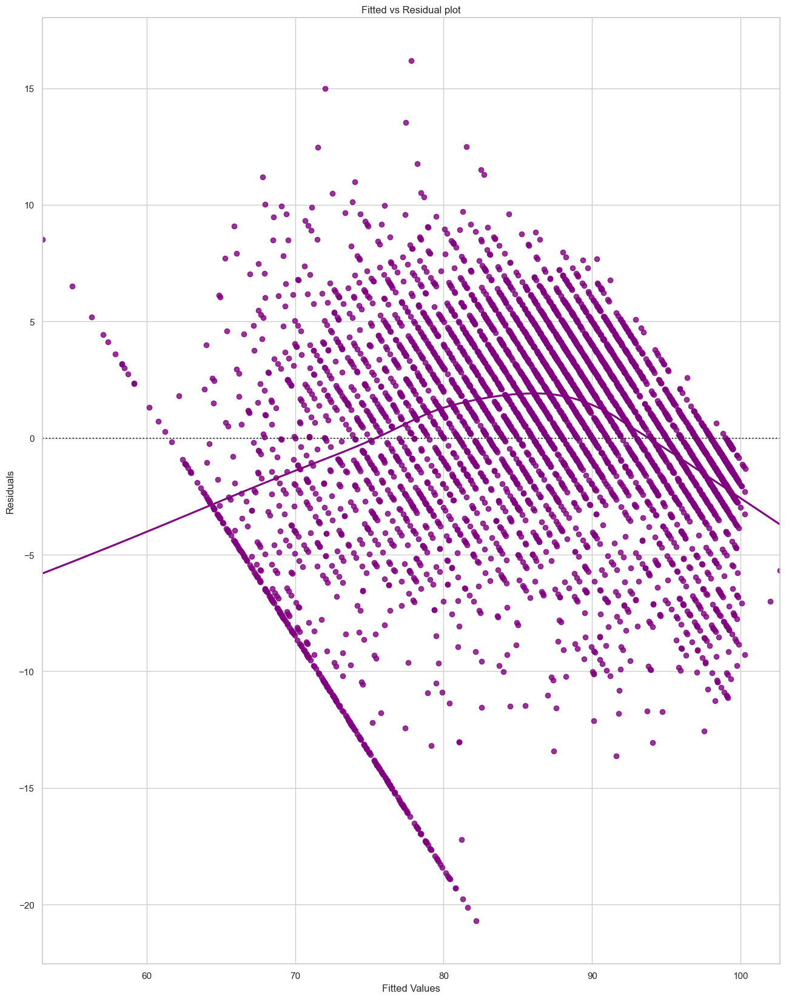

In [51]:
# let us plot the fitted values vs residuals
sns.set_style("whitegrid")
sns.residplot(
    data=df_pred, x="Fitted Values", y="Residuals", color="purple", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

##### No pattern in the data thus the assumption of linearity and independence of predictors satisfied 

In [52]:
# columns in training set
X_train.columns

Index(['const', 'lread', 'scall', 'rchar', 'wchar', 'pgfree', 'atch', 'pgin',
       'pflt', 'freemem', 'freeswap', 'runqsz_Not_CPU_Bound'],
      dtype='object')

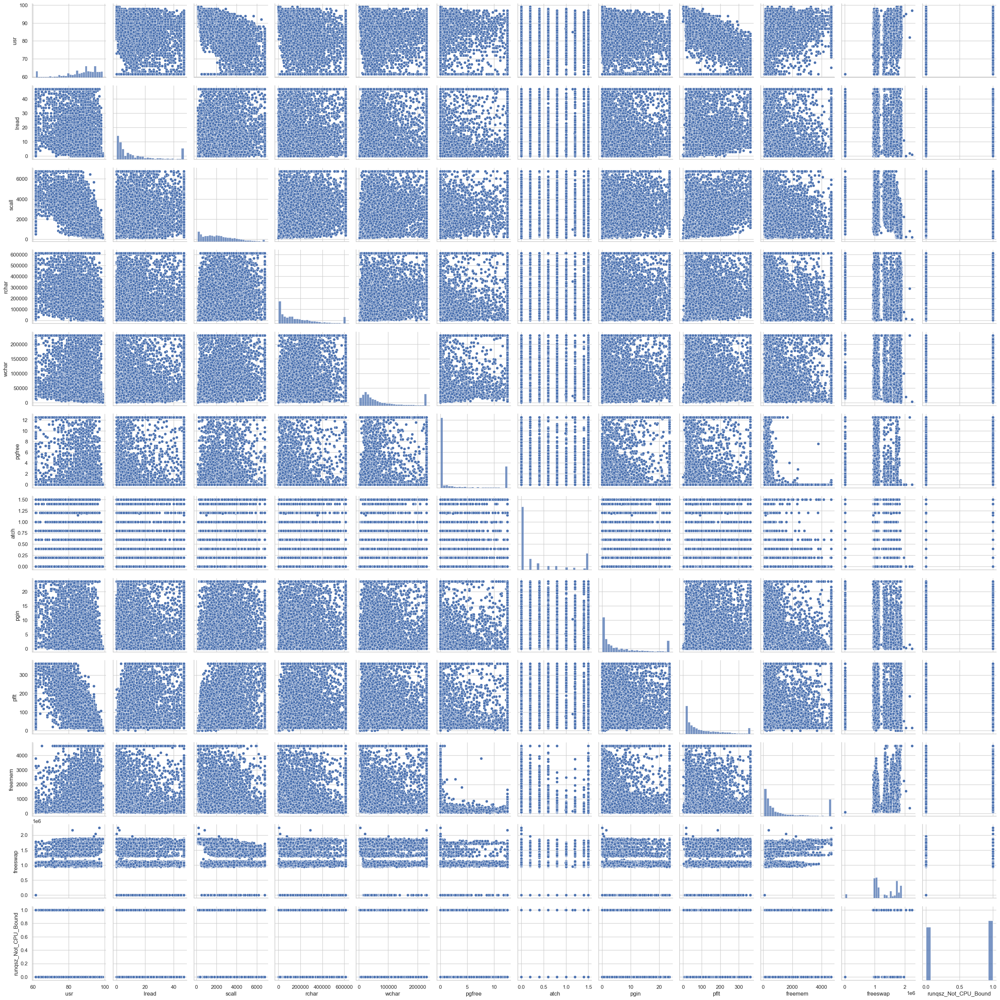

In [53]:
# checking the distribution of variables in training set with dependent variable
sns_plot = sns.pairplot(df[['usr', 'lread', 'scall', 'rchar', 'wchar', 'pgfree', 'atch', 'pgin',
       'pflt', 'freemem', 'freeswap', 'runqsz_Not_CPU_Bound']])
sns_plot.figure.savefig("pairplot.png")
plt.show()

In [54]:
# using square transformation
X_train["scall_sq"] = np.square(X_train["scall"])

# let's create a model with the transformed data
olsmod_5 = sm.OLS(y_train, X_train)
olsres_5 = olsmod_5.fit()
print(olsres_5.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.799
Model:                            OLS   Adj. R-squared:                  0.799
Method:                 Least Squares   F-statistic:                     1895.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:38:00   Log-Likelihood:                -16616.
No. Observations:                5734   AIC:                         3.326e+04
Df Residuals:                    5721   BIC:                         3.335e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   80.9943 

In [55]:
# using square transformation
X_train["pflt_sq"] = np.square(X_train["pflt"])

# let's create a model with the transformed data
olsmod_6 = sm.OLS(y_train, X_train)
olsres_6 = olsmod_6.fit()
print(olsres_6.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.803
Model:                            OLS   Adj. R-squared:                  0.802
Method:                 Least Squares   F-statistic:                     1788.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:38:00   Log-Likelihood:                -16565.
No. Observations:                5734   AIC:                         3.316e+04
Df Residuals:                    5720   BIC:                         3.325e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   80.3258 

In [57]:
# let us recreate the dataframe with actual, fitted and residual values
df_pred = pd.DataFrame()

df_pred["Actual Values"] = y_train.values.flatten()  # actual values
df_pred["Fitted Values"] = olsres_6.fittedvalues.values  # predicted values
df_pred["Residuals"] = olsres_6.resid.values  # residuals

df_pred.head()

,Actual Values,Fitted Values,Residuals
0,91.0,89.130465,1.869535
1,94.0,91.341269,2.658731
2,61.5,74.962262,-13.462262
3,83.0,81.713945,1.286055
4,94.0,97.136625,-3.136625


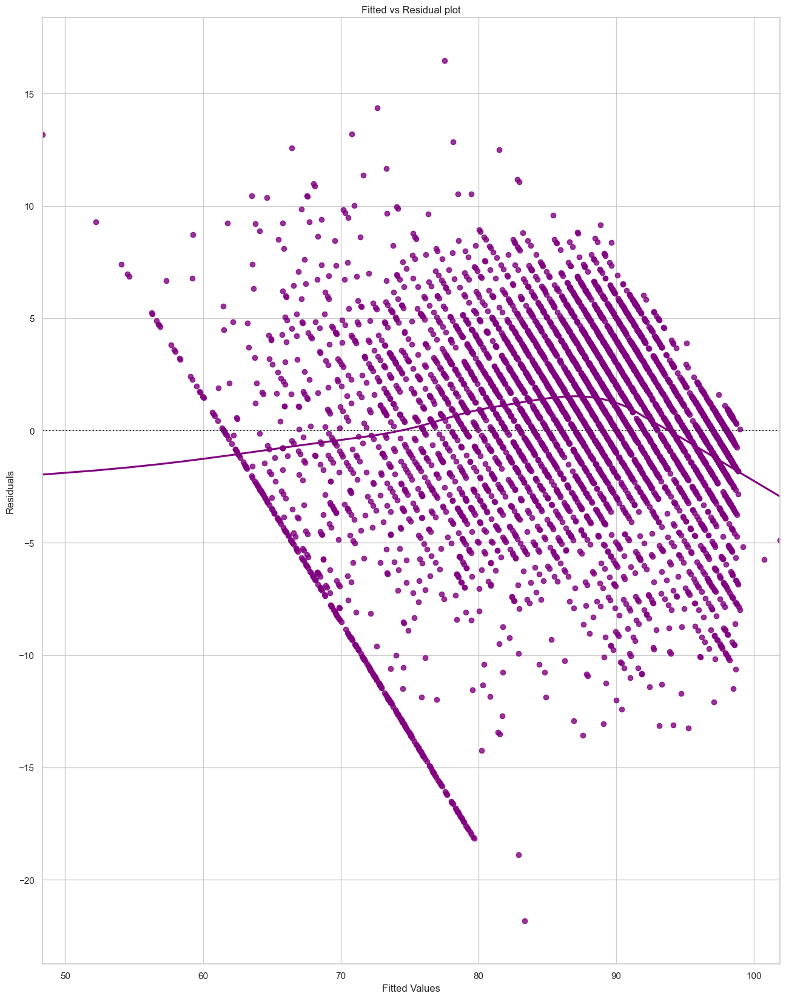

In [58]:
# let us plot the fitted values vs residuals
sns.set_style("whitegrid")
sns.residplot(
    data=df_pred, x="Fitted Values", y="Residuals", color="purple", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

## Test for Normality

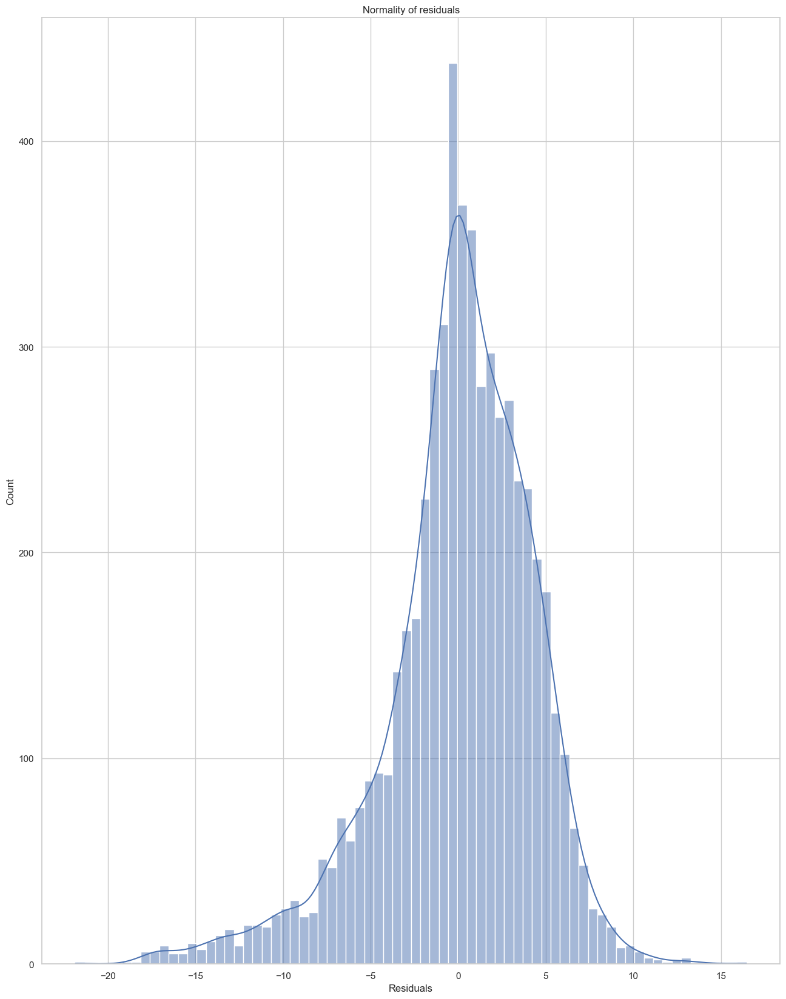

In [59]:
sns.histplot(df_pred["Residuals"], kde=True)
plt.title("Normality of residuals")
plt.show()

In [60]:
w, p1_value = stats.shapiro(df_pred["Residuals"])

print('The p-value for Residuals is', p1_value)

alpha = 0.05  # Set your significance level
if p1_value > alpha:
    print("The data appears to be normally distributed (fail to reject H0)")
else:
    print("The data does not appear to be normally distributed (reject H0)")

The p-value for Residuals is 3.891742147061455e-39
The data does not appear to be normally distributed (reject H0)


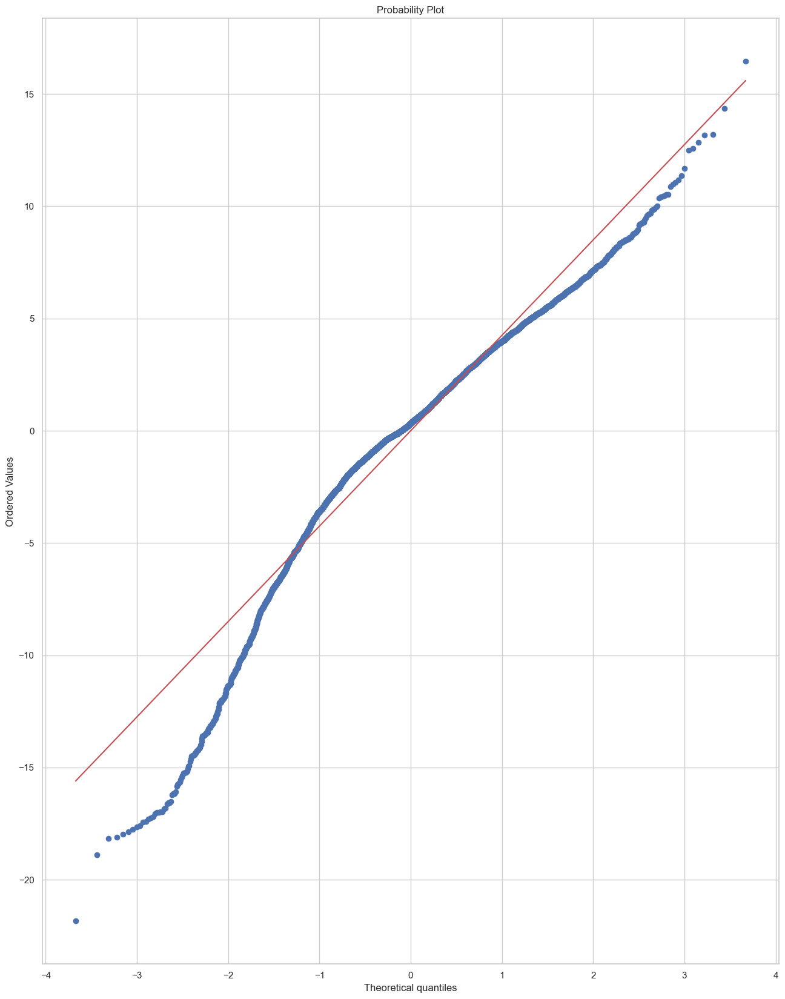

In [61]:
import pylab
import scipy.stats as stats

stats.probplot(df_pred["Residuals"], dist="norm", plot=pylab)
plt.show()

In [62]:
X_train.skew()

const                   0.000000
lread                   1.208855
scall                   0.715733
rchar                   1.119972
wchar                   1.154196
pgfree                  1.195839
atch                    1.160107
pgin                    1.239660
pflt                    1.200329
freemem                 1.196730
freeswap               -0.779456
runqsz_Not_CPU_Bound   -0.120234
scall_sq                1.922564
pflt_sq                 2.019616
dtype: float64

## Test for Homoscedasticity

The null and alternate hypotheses of the goldfeldquandt test are as follows:

* Null hypothesis : Residuals are homoscedastic
* Alternate hypothesis : Residuals have hetroscedasticity

In [63]:
import statsmodels.stats.api as sms
sms.het_goldfeldquandt(df_pred["Residuals"], X_train)[1]

0.011332917693381926

##### Since p-value < 0.05 we can say that the residuals are hetroscedasticity.

## The model built olsmod_6 satisfies some assumptions of Linear Regression

In [64]:
olsres_6.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                    usr   R-squared:                       0.803
Model:                            OLS   Adj. R-squared:                  0.802
Method:                 Least Squares   F-statistic:                     1788.
Date:                Thu, 11 Jan 2024   Prob (F-statistic):               0.00
Time:                        07:39:46   Log-Likelihood:                -16565.
No. Observations:                5734   AIC:                         3.316e+04
Df Residuals:                    5720   BIC:                         3.325e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   80.3258      0.359    223.722      0.000      79.622      81.030
lread                   -0.0406      0.004     -9.385      0.000      -0.049      -0.032
scall                    0.0009      0.000      6.575      0.000       0.001       0.001
rchar                -5.569e-06   4.24e-07    -13.124      0.000    -6.4e-06   -4.74e-06
wchar                -7.545e-06   9.59e-07     -7.870      0.000   -9.42e-06   -5.67e-06
pgfree                  -0.1040      0.016     -6.489      0.000      -0.135      -0.073
atch                     0.3076      0.135      2.282      0.023       0.043       0.572
pgin                    -0.1148      0.009    -12.443      0.000      -0.133      -0.097
pflt                    -0.0271      0.002    -12.676      0.000      -0.031      -0.023
freemem                 -0.0003   5.03e-05     -5.551      0.000      -0.000      -0.000
freeswap              9.528e-06   1.85e-07     51.383      0.000    9.16e-06    9.89e-06
runqsz_Not_CPU_Bound     1.8713      0.124     15.070      0.000       1.628       2.115
scall_sq             -2.861e-07   2.09e-08    -13.678      0.000   -3.27e-07   -2.45e-07
pflt_sq              -6.019e-05   5.93e-06    -10.147      0.000   -7.18e-05   -4.86e-05
==============================================================================
Omnibus:                      839.958   Durbin-Watson:                   2.002
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1613.180
Skew:                          -0.916   Prob(JB):                         0.00
Kurtosis:                       4.843   Cond. No.                     7.84e+07
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 7.84e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## The model equation will be as follows:

In [65]:
# Let us write the equation of linear regression
Equation = "usr ="
print(Equation, end=" ")
for i in range(len(X_train.columns)):
    if i == 0:
        print(olsres_6.params[i], "+", end=" ")
    elif i != len(X_train.columns) - 1:
        print(
            olsres_6.params[i],
            "* (",
            X_train.columns[i],
            ")",
            "+",
            end="  ",
        )
    else:
        print(olsres_6.params[i], "* (", X_train.columns[i], ")")

usr = 80.32578269641903 + -0.04060862245726409 * ( lread ) +  0.0009109432268011643 * ( scall ) +  -5.5691044371107365e-06 * ( rchar ) +  -7.5446719419862535e-06 * ( wchar ) +  -0.10398102553887754 * ( pgfree ) +  0.30760866082751137 * ( atch ) +  -0.1148167884326387 * ( pgin ) +  -0.0271225198213273 * ( pflt ) +  -0.0002793470072376525 * ( freemem ) +  9.5281546836217e-06 * ( freeswap ) +  1.871281340030479 * ( runqsz_Not_CPU_Bound ) +  -2.8613266551192783e-07 * ( scall_sq ) +  -6.018855684078149e-05 * ( pflt_sq )


# Predictions

In [66]:
X_train.columns

Index(['const', 'lread', 'scall', 'rchar', 'wchar', 'pgfree', 'atch', 'pgin',
       'pflt', 'freemem', 'freeswap', 'runqsz_Not_CPU_Bound', 'scall_sq',
       'pflt_sq'],
      dtype='object')

In [67]:
X_test.columns

Index(['const', 'lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec',
       'rchar', 'wchar', 'pgout', 'ppgout', 'pgfree', 'pgscan', 'atch', 'pgin',
       'ppgin', 'pflt', 'vflt', 'freemem', 'freeswap', 'runqsz_Not_CPU_Bound'],
      dtype='object')

In [70]:
# dropping columns from the test data that are not there in the training data
X_test2 = X_test.drop(
    ["exec", "lwrite", "vflt", "swrite", "sread", "pgout", "ppgin", "ppgout", "pgscan", "fork"], axis=1
)

In [73]:
# transforming the weight column in the test data corresponding to the training set
X_test2["scall_sq"] = np.square(X_test2["scall"])
X_test2["pflt_sq"] = np.square(X_test2["pflt"])

In [74]:
# let's make predictions on the test set
y_pred_test = olsres_6.predict(X_test2)
y_pred_train = olsres_6.predict(X_train)

In [75]:
# To check model performance
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [76]:
# let's check the RMSE on the train data
rmse1 = np.sqrt(mean_squared_error(y_train, y_pred_train))
rmse1

4.349243018051866

In [77]:
# let's check the RMSE on the test data
rmse2 = np.sqrt(mean_squared_error(y_test, y_pred_test))
rmse2

4.542132394160572

In [78]:
# let's check the MAE on the train data
mae1 = mean_absolute_error(y_train, df_pred["Fitted Values"])
mae1

3.2083224632361858

In [79]:
# let's check the MAE on the test data
mae2 = mean_absolute_error(y_test, y_pred_test)
mae2

3.260139643316443

# Sci-Kit Learn Linear Regression

In [80]:
# invoke the LinearRegression function and find the bestfit model on training data
from sklearn.linear_model import LinearRegression
regression_model = LinearRegression()
regression_model.fit(X_train, y_train)

LinearRegression()

In [81]:
# Let us explore the coefficients for each of the independent attributes

for idx, col_name in enumerate(X_train.columns):
    print("The coefficient for {} is {}".format(col_name, regression_model.coef_[0][idx]))

The coefficient for const is 0.0
The coefficient for lread is -0.040608622458206595
The coefficient for scall is 0.0009109432268176952
The coefficient for rchar is -5.569104437094579e-06
The coefficient for wchar is -7.544671942038639e-06
The coefficient for pgfree is -0.10398102553937687
The coefficient for atch is 0.3076086608290831
The coefficient for pgin is -0.11481678843273727
The coefficient for pflt is -0.02712251982132653
The coefficient for freemem is -0.0002793470072352273
The coefficient for freeswap is 9.528154683609963e-06
The coefficient for runqsz_Not_CPU_Bound is 1.8712813400322006
The coefficient for scall_sq is -2.861326655126395e-07
The coefficient for pflt_sq is -6.018855684120802e-05


In [82]:
# Let us check the intercept for the model

intercept = regression_model.intercept_[0]

print("The intercept for our model is {}".format(intercept))

The intercept for our model is 80.32578269653469


In [83]:
# R square on training data
regression_model.score(X_train, y_train)

0.8025428491193711

In [84]:
# R square on testing data
regression_model.score(X_test2, y_test)

0.7786015387667776

In [85]:
#RMSE on Training data
from sklearn import metrics

predicted_train=regression_model.fit(X_train, y_train).predict(X_train)
np.sqrt(metrics.mean_squared_error(y_train,predicted_train))

4.349243018051866

In [86]:
#RMSE on Testing data
predicted_test=regression_model.fit(X_train, y_train).predict(X_test2)
np.sqrt(metrics.mean_squared_error(y_test,predicted_test))

4.542132394160525